# Reference

The data set has been taken from Graham, Daniel B. and Allinson, Nigel (1998) Face database [Datset](http://eprints.lincoln.ac.uk/id/eprint/16081/)

The following Github link has been used for reference [Repository](https://github.com/Ugenteraan/Face-Recognition-Eigenface-Scratch)



# Read Me

There are two zip files that need to be added before running below snippets. Zip files need to be added in the content directory.

# Assumptions

There are total 20 different faces. Each face has different 15-25 different angle,lighting images. 

Some of these images has been removed from the dataset and used as test images. So there are total 20 test images and 546 dataset images.

To find the accuracy, each test image is compared with 546 images of the dataset and error is found. 4000 has been kept has threshold for error. Thats is if error is less than 4000 than image is detected otherwise not.
All 20 faces are labbeled as 1a to 1t. 

Accuracy for a face is defined as (TP+TN)/(TP+TN+FP+FN)

In [1]:
# Run this file to unzip the uploaded dataset
import zipfile
with zipfile.ZipFile("test.zip","r") as zip_ref:
    zip_ref.extractall()
with zipfile.ZipFile("cropped.zip","r") as zip_ref:
    zip_ref.extractall()

In [2]:
# importiting utilities
import os, glob
from sklearn import preprocessing
import cv2
import numpy as np
import matplotlib.pyplot as plt
import math

In [5]:
# setting path to the dataset
dataset_path = os.getcwd() + '/cropped/'
test_path = os.getcwd() + '/test/'

In [6]:
#function to plot the images
def plot_portraits(images, titles, h, w, n_row, n_col):
    plt.figure(figsize=(2.2 * n_col, 2.2 * n_row))
    plt.subplots_adjust(bottom=0, left=.01, right=.99, top=.90, hspace=.20)
    for i in range(n_row * n_col):
        plt.subplot(n_row, n_col, i + 1)
        plt.imshow(images[i].reshape((h, w)), cmap=plt.cm.gray)
        plt.title(titles[i])
        plt.xticks(())
        plt.yticks(())

In [8]:
#to get the total number of images
total_images = 0
shape = None
for images in glob.glob(dataset_path + '/**', recursive=True):
    if images[-3:] == 'pgm':
        total_images += 1

print(total_images)

546


In [49]:
shape = (112,92)                                                                 #size of the images
all_images = np.zeros((total_images, shape[0], shape[1]) ,dtype='float64')       #initialize the numpy array
names = list()
i = 0
for folder in glob.glob(dataset_path + '/*'+'/face'):                            #iterate through all the class
    for image in glob.glob(folder + '/*'):                                       #iterate through each folder (class)
        names.append(folder[-7:-5])                                              #list for the different faces
        read_image = cv2.imread(image, cv2.IMREAD_GRAYSCALE)                     #read the image in grayscale
        resized_image = cv2.resize(read_image, (shape[1], shape[0]))             #cv2.resize resizes an image into (# column x # height)
        all_images[i] = np.array(resized_image)
        i += 1
plot_portraits(all_images, names, 112,92, 21, 26)                                #plotting all 546 images with names


546


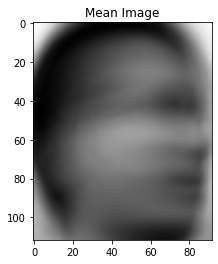

In [16]:
A = np.resize(all_images, (total_images, shape[0]*shape[1]))                     #convert the images into vectors. Each row has an image vector. i.e. all_images x image_vector matrix
mean_vector = np.sum(A, axis=0, dtype='float64')/total_images                    #calculate the mean vector
mean_matrix = np.tile(mean_vector, (total_images, 1))                            #make a 546 copy of the same vector. 574 x image_vector_size matrix.
A_tilde = A - mean_matrix                                                        #mean-subtracted image vectors
plt.imshow(np.resize(mean_vector, (shape[0],shape[1])), cmap='gray')             #show the mean image vector
plt.title('Mean Image')
plt.show()

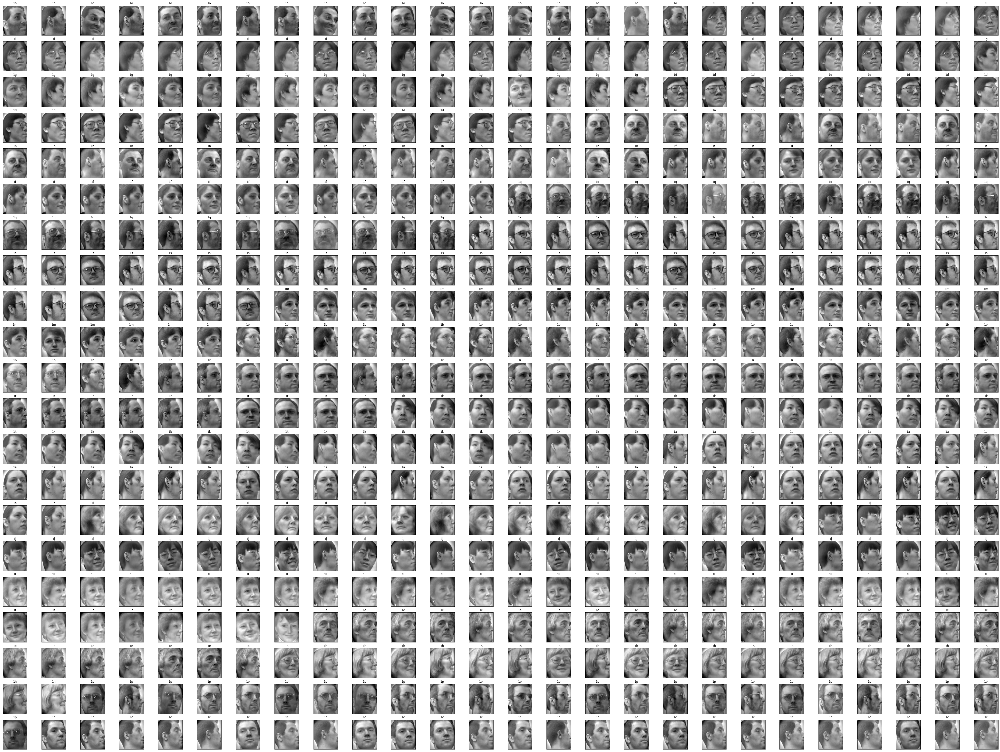

In [17]:
plot_portraits(A_tilde, names, 112,92, 21, 26)                                   # matrix A_tilde that contains vectors of each mean subtracted img

In [18]:
L = (A_tilde.dot(A_tilde.T))/total_images                                        #since each row is an image vector (unlike in the notes, L = (A_tilde)(A_tilde.T) instead of L = (A_tilde.T)(A_tilde)
print("L shape : ", L.shape)
eigenvalues, eigenvectors = np.linalg.eig(L)                                     #find the eigenvalues and the eigenvectors of L
idx = eigenvalues.argsort()[::-1]                                                #get the indices of the eigenvalues by its value. Descending order.
eigenvalues = eigenvalues[idx] 
eigenvectors = eigenvectors[:, idx]                                              #sorted eigenvalues and eigenvectors in descending order

L shape :  (546, 546)


In [19]:
eigenvectors_C = A_tilde.T @ eigenvectors                                        #linear combination of each column of A_tilde
eigenvectors_C.shape                                                             #each column is an eigenvector of C where C = (A_tilde.T)(A_tilde). NOTE : in the notes, C = (A_tilde)(A_tilde.T)

(10304, 546)

In [20]:
#normalize the eigenvectors
eigenfaces = preprocessing.normalize(eigenvectors_C.T)                           #normalize only accepts matrix with n_samples, n_feature. Hence the transpose.
eigenfaces.shape

(546, 10304)

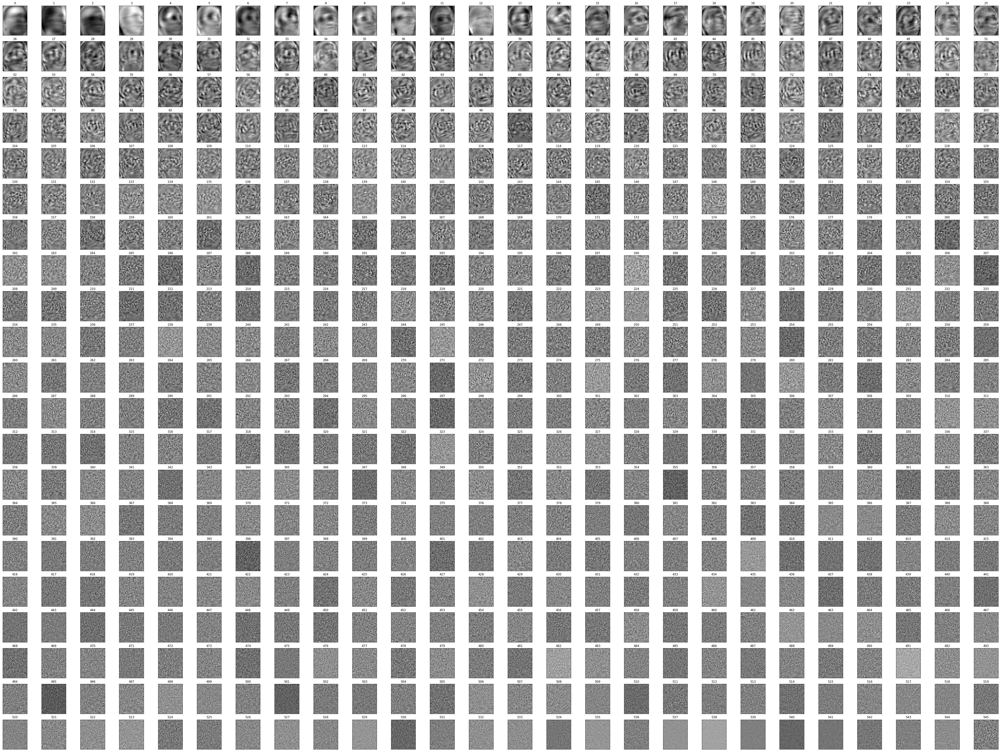

In [35]:
#to visualize some of the eigenfaces
eigenface_labels = [x for x in range(eigenfaces.shape[0])]                       #list containing values from 1 to number of eigenfaces
plot_portraits(eigenfaces, eigenface_labels , 112,92, 21, 26) 

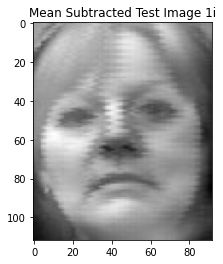

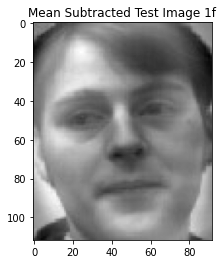

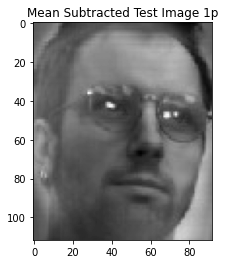

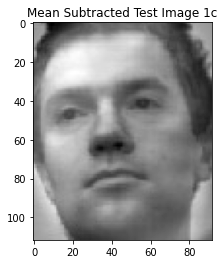

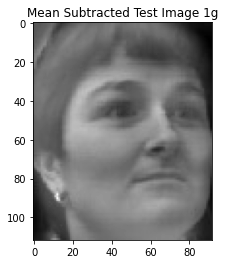

...

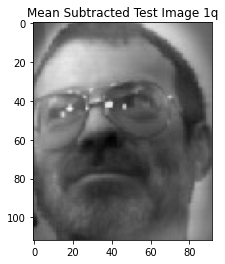

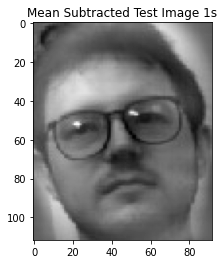

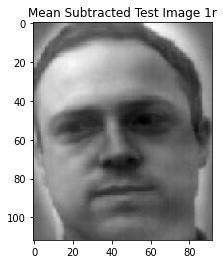

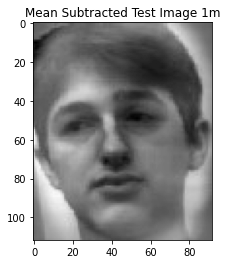

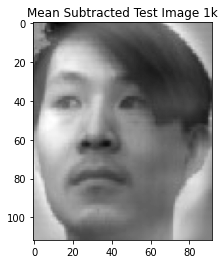

In [36]:
test_images = np.zeros((20, shape[0], shape[1]) ,dtype='float64')                #initialize the numpy array
test_images_mean_subtracted = np.zeros((20, 10304, ) ,dtype='float64') 
test_names = list()
cnt = 0
for folder in glob.glob(test_path + '/*'):  
  test_names.append(folder[-6:-4]) 
  test_img = cv2.imread(folder, cv2.IMREAD_GRAYSCALE)                             #testing image
  test_img = cv2.resize(test_img, (shape[1],shape[0]))                            #resize the testing image. cv2 resize by width and height.
  mean_subracted_testimg = np.reshape(test_img, (test_img.shape[0]*test_img.shape[1])) - mean_vector #subtract the mean
  plt.imshow(np.reshape(mean_subracted_testimg, (112,92)), cmap='gray')
  plt.title("Mean Subtracted Test Image "+test_names[-1])
  plt.show()
  test_images[cnt] = np.array(test_img)
  test_images_mean_subtracted[cnt] = np.array(mean_subracted_testimg)
  cnt = cnt+1

In [38]:
q = 400 
omega = list()
for i in range(20):                                                              #number of chosen eigenfaces
  omega.append(eigenfaces[:q].dot(test_images_mean_subtracted[i]))               #the vector that represents the image with respect to the eigenfaces.
  print(omega[i].shape)

(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)
(400,)


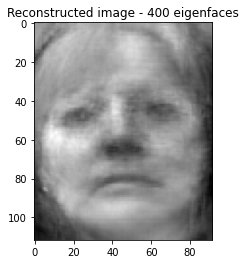

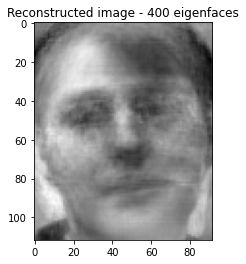

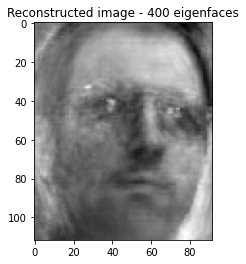

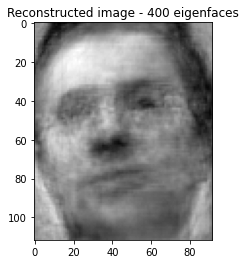

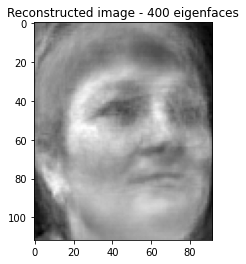

...

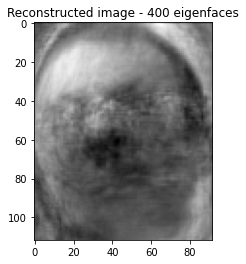

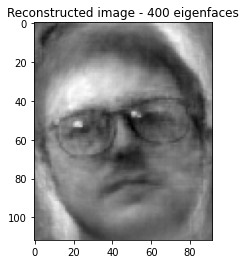

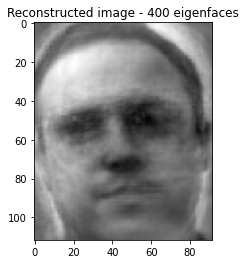

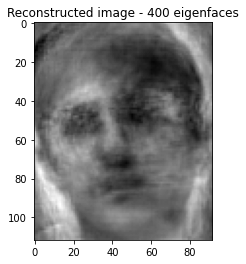

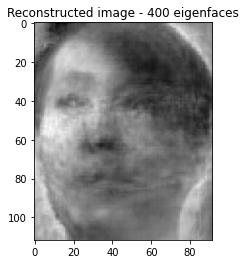

In [39]:
#To visualize the reconstruction
for i in range(20): 
  reconstructed = eigenfaces[:q].T.dot(omega[i])                                      #image reconstructed using q eigenfaces.
  plt.imshow(np.reshape(reconstructed, (shape[0],shape[1])), cmap='gray')
  plt.title("Reconstructed image - "+str(q)+" eigenfaces")
  plt.show()

In [43]:
alpha_1 = 4000                                                                   #chosen threshold for face detection

for i in range(20):
  projected_new_img_vector = eigenfaces[:q].T @ omega[i]                              #n^2 vector of the new face image represented as the linear combination of the chosen eigenfaces
  diff = test_images_mean_subtracted[i] - projected_new_img_vector 
  beta = math.sqrt(diff.dot(diff))                                                 #distance between the original face image vector and the projected vector.
  if beta < alpha_1:
    print("Face detected in the image " + test_names[i] +"!", beta)
  else:
    print("No face detected in the image! " + test_names[i], beta)

Face detected in the image 1i! 844.7336303642053
Face detected in the image 1f! 990.5052439879049
Face detected in the image 1p! 1177.8956297817058
Face detected in the image 1c! 1414.6047836558896
Face detected in the image 1g! 883.2204603645707
Face detected in the image 1b! 1689.8541913364788
Face detected in the image 1o! 1051.331230962214
Face detected in the image 1h! 1313.9322534250543
Face detected in the image 1d! 1654.624886114489
Face detected in the image 1e! 1255.6080844317605
Face detected in the image 1t! 193.0975625696388
Face detected in the image 1n! 755.5506160900487
Face detected in the image 1l! 1687.5603010120317
Face detected in the image 1j! 1471.5700242594842
Face detected in the image 1a! 1582.4376215666848
Face detected in the image 1q! 1514.3391435776728
Face detected in the image 1s! 1097.0827482663556
Face detected in the image 1r! 932.6582846947522
Face detected in the image 1m! 1255.3882639297815
Face detected in the image 1k! 1535.3259757252379


In [54]:
alpha_2 = 4000                                                                   #chosen threshold for face recognition
count = 0  
tp_tn = 0                                                                      #to keep track of the smallest value
index = None
for x in range (20):    
   face_cnt = 0 
   tp=0
   tn=0                                                        #to keep track of the class that produces the smallest value
   for k in range(total_images):
      omega_k = eigenfaces[:q].dot(A_tilde[k])                                   #calculate the vectors of the images in the dataset and represent 
      diff = omega[x] - omega_k
      epsilon_k = math.sqrt(diff.dot(diff))
      if(names[k] == test_names[x]):
        face_cnt = face_cnt + 1
        if alpha_2 >= epsilon_k:
          tp = tp + 1 
      else:
        if alpha_2 < epsilon_k:
          tn = tn + 1
   print("Detected tp", tp,"& tn",tn,"for ",face_cnt, " images of face ", test_names[x])
   tp_tn = tp_tn + tp + tn 

Detected tp 12 & tn 520 for  19  images of face  1i
Detected tp 3 & tn 519 for  22  images of face  1f
Detected tp 6 & tn 513 for  25  images of face  1p
Detected tp 1 & tn 521 for  25  images of face  1c
Detected tp 6 & tn 513 for  18  images of face  1g
Detected tp 1 & tn 522 for  24  images of face  1b
Detected tp 4 & tn 524 for  18  images of face  1o
Detected tp 7 & tn 499 for  21  images of face  1h
Detected tp 2 & tn 523 for  23  images of face  1d
Detected tp 7 & tn 506 for  25  images of face  1e
Detected tp 8 & tn 512 for  34  images of face  1t
Detected tp 7 & tn 508 for  29  images of face  1n
Detected tp 1 & tn 513 for  33  images of face  1l
Detected tp 8 & tn 513 for  31  images of face  1j
Detected tp 0 & tn 509 for  37  images of face  1a
Detected tp 6 & tn 517 for  25  images of face  1q
Detected tp 12 & tn 493 for  47  images of face  1s
Detected tp 15 & tn 504 for  32  images of face  1r
Detected tp 8 & tn 512 for  25  images of face  1m
Detected tp 3 & tn 513 for  

In [52]:
accuracy = tp_tn*100/(20*546)
print("Accuracy of face detection is", accuracy)

Accuracy of face detection is 94.97252747252747
